Import

In [1]:
import sys
import itertools

import numpy as np
import pandas as pd
import scipy.signal
from scipy.signal import savgol_filter
from scipy.stats import zscore
from tqdm import tqdm

import neuroseries as nts


import time
import matplotlib.pyplot as plt

import seaborn as sns 
import bk.load
import bk.compute
import bk.plot
import bk.signal
import bk.stats

import os


import astropy.stats as apy
plt.rcParams['svg.fonttype'] = 'none'

In [86]:
def fr(spikes,state):
    return(len(spikes.restrict(state))/state.tot_length(time_units='s'))

def mod_stats(spikes,phases,nbins,subsample):
    phases_signal_distrib, _ = np.histogram(phases.values,nbins,density=True)
    phases_signal_distrib = phases_signal_distrib*nbins / np.sum(phases_signal_distrib)

    if subsample:
        spikes = nts.Ts(np.random.choice(spikes.index.values,subsample)) 
        
    neuron_phase = phases.realign(spikes)
    stats = {
        'pvalue':np.nan,
        'kappa':np.nan,
        'MRL':np.nan
    }

    
    if len(neuron_phase) == 0: return _,_,stats

    phases_distribution, bin_p = np.histogram(neuron_phase.values, nbins) 
    phases_distribution = phases_distribution/phases_signal_distrib

    bin_p = np.convolve(bin_p, [.5, .5], 'same')[1::]

    stats['pvalue'] = bk.stats.rayleigh(bin_p,weights = phases_distribution)
    stats['kappa'] = bk.compute.concentration(bin_p,weights = phases_distribution)
    stats['MRL'] = bk.compute.mean_resultant_length(bin_p,weights = phases_distribution)

    return bin_p,phases_distribution,stats
    
def phase_mod(neurons,metadata,state,low,high,nbins = 1000,channel=None):
    
    if low >50:
        return phase_mod_local(neurons,metadata,state,low,high,nbins = 1000)
            
    lfp = bk.load.lfp_in_intervals(channel,state)
    lfp_filt = bk.signal.passband(lfp,low,high,1250,2)
    power, phase = bk.signal.hilbert(lfp_filt)

    stats = {'fr_rem': [],
             'pvalue': [],
             'kappa': [],
             'MRL': [],
             'modulated':[]}
    for i,n in tqdm(enumerate(neurons)):
        bin_p, phases_distributions,stat = mod_stats(n.restrict(state),phase,nbins,100)
        stats['fr_rem'].append(fr(n,state))
        for k, s in stat.items():
            stats[k].append(s)
        if (stat['pvalue'] < 0.01) and stat['MRL'] > 0.04:
            stats['modulated'].append(True)
        else:
            stats['modulated'].append(False)

    phase_lock = pd.DataFrame({'FR_Rem': stats['fr_rem'],
                               'MRL': stats['MRL'],
                               'Kappa': stats['kappa'],
                               'pValue': stats['pvalue'],
                               'modulated': stats['modulated']})
    
        
    return bin_p,phases_distributions,phase_lock


def phase_mod_local(neurons, metadata, state, low, high, nbins=100):

    stats = {'fr_rem': [],
                'pvalue': [],
                'kappa': [],
                'MRL': [],
                'modulated':[]}
    phases_distributions = np.zeros((nbins, len(neurons)))

    previous_channel = 0

    for i, (n, m) in tqdm(enumerate(zip(neurons, metadata.iloc)),total=len(np.unique(metadata.Shank))):
        shank_neighbour = bk.load.shank_neighbours(m.Shank)

        if np.isfinite(shank_neighbour['medial']):
            neighbour_channel = bk.load.best_channel(shank_neighbour['medial'])
        else:
            neighbour_channel = bk.load.best_channel(
                shank_neighbour['lateral'])
        if previous_channel != neighbour_channel:
            previous_channel = neighbour_channel

            lfp = bk.load.lfp_in_intervals(neighbour_channel, state)
            lfp_filt = bk.signal.passband(lfp, low, high)
            power, phases = bk.signal.hilbert(lfp_filt)

        bin_p, phases_distributions[:, i], stat = mod_stats(n.restrict(state), phases, nbins)


        stats['fr_rem'].append (len(n.restrict(state))/state.tot_length(time_units='s'))

        for k, s in stat.items():
            stats[k].append(s)

        if (stat['pvalue'] < 0.01) and stat['MRL'] > 0.04:
            stats['modulated'].append(True)
        else:
            stats['modulated'].append(False)

    phase_lock = pd.DataFrame({'FR_Rem': stats['fr_rem'],
                                'MRL': stats['MRL'],
                                'Kappa': stats['kappa'],
                                'pValue': stats['pvalue'],
                                'modulated': stats['modulated']})

    return bin_p, phases_distributions, phase_lock


In [87]:
def plot_phase_mod(phases, mod, metadata, ax=None,polar = False):
    if ax is None:
        fig, ax = plt.subplots(1, 1)
        if polar: fig.add_subplot(1,1,polar)

    ax.bar(phases, mod, phases[1]-phases[0], color='lightblue')
    ax.bar(phases+2*np.pi, mod, phases[1]-phases[0], color='lightblue')

    # plt.suptitle(f'Neuron #{metadata.name}, Shank = {metadata.Shank}, Region = {metadata.Region}, Type = {metadata.Type}  \nFR_Rem = {metadata.FR_Rem} Hz \npValue = {metadata.pValue} \n MRL = {metadata.MRL}, Kappa = {metadata.Kappa} \n Modulated : {metadata.modulated}')
    plt.suptitle(f'Neuron #{metadata.name}, Shank = {metadata.Shank}, Region = {metadata.Region}, Type = {metadata.Type}  \npValue = {metadata.pValue} \n MRL = {metadata.MRL}\n Modulated : {metadata.modulated}')
    if metadata.modulated:
        # ax.set_facecolor('lightgreen')
        ax.set_facecolor('lightgreen')
    plt.tight_layout()



In [88]:
# def original_phasemod(neurons,metadata,state,low,high,nbins = 1000,channel=None):
#     lfp = bk.load.lfp_in_intervals(channel,state)
#     lfp_filt = bk.signal.passband(lfp,low,high,1250,2)
#     power, phase = bk.signal.hilbert(lfp_filt)

#     phases_signal_distrib, _ = np.histogram(phase.values,nbins,density=True)
#     phases_signal_distrib = phases_signal_distrib*nbins / np.sum(phases_signal_distrib)

#     neurons_phase = []
#     neurons_rem_fr = []
#     for i, n in tqdm(enumerate(neurons)):
#         neurons_phase.append(phase.realign(n.restrict(state)))
#         neurons_rem_fr.append(
#             len(n.restrict(state))/state.tot_length(time_units='s'))

#     pvalues = []
#     kappas = []
#     modulated = []
#     MRLs = []
#     phases_distributions = np.zeros((nbins,len(neurons)))
#     for i, p in tqdm(enumerate(neurons_phase)):
        
#         if len(p) == 0:
#             pvalues.append(np.nan)
#             kappas.append(np.nan)
#             modulated.append(np.nan)
#             MRLs.append(np.nan)
#             continue


#         phases_distributions[:,i], bin_p = np.histogram(neurons_phase[i].values, nbins) 
#         phases_distributions[:,i] = phases_distributions[:,i]/phases_signal_distrib
#         bin_p = np.convolve(bin_p, [.5, .5], 'same')[1::]


#         pvalue = bk.stats.rayleigh(bin_p,weights = phases_distributions[:,i])
#         pvalues.append(pvalue)

#         kappa = bk.compute.concentration(p.values)
#         kappas.append(kappa)

#         MRL = bk.compute.mean_resultant_length(bin_p,weights = phases_distributions[:,i])
#         MRLs.append(MRL)
#         if (pvalue < 0.01) and MRL > 0.04:
#             modulated.append(True)
#         else:
#             modulated.append(False)


#     phase_lock = pd.DataFrame({'FR_Rem': neurons_rem_fr,
#                             'MRL': MRLs,
#                             'Kappa': kappas,
#                             'pValue': pvalues,
#                             'modulated': modulated})

#     return bin_p,phases_distributions,phase_lock
    

In [89]:
# def phase_mod_legacy(neurons,metadata,state,low,high,nbins = 1000,channel=None):

#     if low >50:
#         return phase_mod_local(neurons,metadata,state,low,high,nbins = 1000)
    
#     lfp = bk.load.lfp_in_intervals(channel,state)
#     lfp_filt = bk.signal.passband(lfp,low,high,1250,2)
#     power, phase = bk.signal.hilbert(lfp_filt)

#     # stats = {'fr_rem': [],
#     #          'pvalue': [],
#     #          'kappa': [],
#     #          'MRL': [],
#     #          'modulated':[]}
#     # for i,n in tqdm(enumerate(neurons)):
#     #     bin_p, phases_distributions,stat = mod_stats(n,phase,nbins)
#     #     stats['fr_rem'].append(fr(n,state))
#     #     for k, s in stat.items():
#     #         stats[k].append(s)
#     #     if (stat['pvalue'] < 0.01) and stat['MRL'] > 0.04:
#     #         stats['modulated'].append(True)
#     #     else:
#     #         stats['modulated'].append(False)

#     # phase_lock = pd.DataFrame({'FR_Rem': stats['fr_rem'],
#     #                            'MRL': stats['MRL'],
#     #                            'Kappa': stats['kappa'],
#     #                            'pValue': stats['pvalue'],
#     #                            'modulated': stats['modulated']})
    
        
#     # return bin_p,phases_distributions,phase_lock


#     phases_signal_distrib, _ = np.histogram(phase.values,nbins,density=True)
#     phases_signal_distrib = phases_signal_distrib*nbins / np.sum(phases_signal_distrib)


#     neurons_phase = []
#     neurons_rem_fr = []
#     for i, n in tqdm(enumerate(neurons)):
#         neurons_phase.append(phase.realign(n.restrict(state)))
#         neurons_rem_fr.append(
#             len(n.restrict(state))/state.tot_length(time_units='s'))

#     pvalues = []
#     pvalues_bis = []
#     kappas = []
#     modulated = []
#     modulated_bis = []
#     MRLs = []
#     MRLs_bis = []
#     phases_distributions = np.zeros((nbins,len(neurons)))
#     for i, p in tqdm(enumerate(neurons_phase)):
        
#         if len(p) == 0:
#             pvalues.append(np.nan)
#             pvalues_bis.append(np.nan)
#             kappas.append(np.nan)
#             modulated.append(np.nan)
#             modulated_bis.append(np.nan)
#             MRLs.append(np.nan)
#             MRLs_bis.append(np.nan)
#             continue


#         phases_distributions[:,i], bin_p = np.histogram(neurons_phase[i].values, nbins) 
#         phases_distributions[:,i] = phases_distributions[:,i]/phases_signal_distrib
#         bin_p = np.convolve(bin_p, [.5, .5], 'same')[1::]


#         pvalue = apy.rayleightest(p.values)
#         pvalues.append(pvalue)


#         pvalue_bis = bk.stats.rayleigh(bin_p,weights = phases_distributions[:,i])
#         pvalues_bis.append(pvalue_bis)

#         kappa = bk.compute.concentration(p.values)
#         kappas.append(kappa)

#         MRL = bk.compute.mean_resultant_length(p.values)

#         MRL_bis = bk.compute.mean_resultant_length(bin_p,weights = phases_distributions[:,i])
#         MRLs.append(MRL)
#         MRLs_bis.append(MRL_bis)
#         if (pvalue < 0.01) and MRL > 0.04:
#             modulated.append(True)
#         else:
#             modulated.append(False)

#         if(pvalue_bis < 0.01) and MRL_bis > 0.04:
#             modulated_bis.append(True)
#         else:
#             modulated_bis.append(False)



#     phase_lock = pd.DataFrame({'FR_Rem': neurons_rem_fr,
#                             'MRL': MRLs,
#                             'MRL_bis':MRLs_bis,
#                             'Kappa': kappas,
#                             'pValue': pvalues,
#                             'pValue_bis':pvalues_bis,
#                             'modulated': modulated,
#                             'modulated_bis':modulated_bis})

    
#     # fig, ax = plt.subplots(1, 1)
#     # ax.bar(bin_p, phases_signal_distrib, bin_p[1]-bin_p[0], color='lightblue')
#     # ax.bar(bin_p+2*np.pi, phases_signal_distrib, bin_p[1]-bin_p[0], color='lightblue')

#     return bin_p,phases_distributions,phase_lock


In [90]:
def main(base_folder,local_path,*args,**kwargs):
    bk.load.current_session_linux(base_folder,local_path)


    # if os.path.exists('Analysis/Thetamod/hpc_theta_phase_lock.csv'):
    #     metadata_phaselock = pd.read_csv('Analysis/Thetamod/hpc_theta_phase_lock.csv')
    #     (phases,phases_modulations) = np.load('Analysis/Thetamod/hpc_theta_phases_mod.npy')

    #     return (phases,phases_modulations), metadata_phaselock

    
    states = bk.load.states()
    neurons, metadata = bk.load.spikes()
    phases,phases_modulations,metadata_phaselock = phase_mod(neurons,metadata,states['Rem'],6,10,channel=bk.load.ripple_channel())
    metadata_phaselock = pd.concat([metadata, metadata_phaselock], axis=1)

    # np.save('Analysis/Thetamod/hpc_theta_phases_mod.npy',(phases,phases_modulations))
    # metadata_phaselock.to_csv('Analysis/Thetamod/hpc_theta_phase_lock.csv', index = False)

    return (phases,phases_modulations), metadata_phaselock


In [91]:
def main_local(base_folder,local_path,*args,**kwargs):

    fmin,fmax = kwargs['f_range']
    state = kwargs['state']
    
    bk.load.current_session_linux(base_folder,local_path)

    states = bk.load.states()
    neurons, metadata = bk.load.spikes()
    phases,phases_modulations,metadata_phaselock = phase_mod_local(neurons,metadata,states[state],fmin,fmax,nbins = 50)
    metadata_phaselock = pd.concat([metadata, metadata_phaselock], axis=1)

    return (phases,phases_modulations), metadata_phaselock


In [92]:
def merge(batch):
    phases_modulations_all = []
    metadata_phaselock_all = []
    for i,b in batch.items():
        phases_modulations_all.append(b[0][1])
        metadata_phaselock_all.append(b[1])

    phases = b[0][0]
    phases_modulations_all = np.hstack(phases_modulations_all)
    metadata_phaselock_all = pd.concat(metadata_phaselock_all)

    return phases, phases_modulations_all,metadata_phaselock_all

In [76]:
(phases,phases_modulations), metadata_phaselock = main('/mnt/electrophy/Gabrielle/GG-Dataset-Light/','Rat08/Rat08-20130713')

Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
Data already saved in Numpy format, loading them from here:
Rat08-20130713-neurons.npy
Rat08-20130713-metadata.npy


0it [00:00, ?it/s]/home/billel/pCloudDrive/IFM/work/Code/Python/Billel/neuroseries/time_series.py:129: UserWarning: timestamps are not sorted
  warn('timestamps are not sorted', UserWarning)
252it [00:09, 26.50it/s]


In [82]:
metadata_phaselock.Type

0      Pyr
1      Pyr
2      Pyr
3      Pyr
4      Pyr
      ... 
247    Pyr
248    Pyr
249    Pyr
250    Pyr
251    Pyr
Name: Type, Length: 252, dtype: object

In [83]:
bla = metadata_phaselock[(metadata_phaselock.Region == 'BLA')&  (metadata_phaselock['Type'] == 'Pyr')][['FR_Rem','modulated']]

bla.modulated[bla.modulated == True] = 'True'
bla.modulated[bla.modulated == False] = 'False'

/tmp/ipykernel_52192/2554377170.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bla.modulated[bla.modulated == False] = 'False'


<AxesSubplot:xlabel='modulated', ylabel='FR_Rem'>

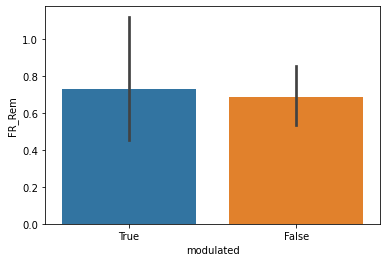

In [85]:
sns.barplot(data = bla,x = bla.modulated,y = bla.FR_Rem)

In [93]:
batch, metadata = bk.load.batch(main)
phases, phases_modulations_all,metadata_phaselock_all = merge(batch)
metadata_phaselock_all.to_csv(f'{bk.load.base}/All-Rats/all_theta_mod-downsampled.csv',index = False)

100%|██████████| 61/61 [14:55<00:00, 14.67s/it]


Batch finished in 895.1121802330017
Some session were not processed correctly
['Rat08-20130712', 'Rat08-20130718', 'Rat08-20130719', 'Rat08-20130720', 'Rat08-20130722', 'Rat09-20140324', 'Rat09-20140325', 'Rat09-20140326', 'Rat09-20140327', 'Rat09-20140328', 'Rat09-20140329', 'Rat09-20140331', 'Rat09-20140401', 'Rat09-20140402', 'Rat09-20140403', 'Rat09-20140404', 'Rat09-20140405', 'Rat09-20140407', 'Rat09-20140408', 'Rat09-20140409', 'Rat11-20150316', 'Rat11-20150402', 'Rat11-20150403']
37.704918032786885 %


In [8]:
kwargs = {'f_range': [5, 10],
          'state': 'Rem'}
(phases_theta, phases_modulations_theta), metadata_phaselock_theta = main(
    '/mnt/electrophy/Gabrielle/GG-Dataset-Light/', 'Rat08/Rat08-20130713', **kwargs)

# kwargs = {'f_range': [60, 80],
#           'state':'Rem'}
# (phases_gamma,phases_modulations_gamma), metadata_phaselock_gamma = main_local(
#     '/mnt/electrophy/Gabrielle/GG-Dataset-Light/', 'Rat08/Rat08-20130713',**kwargs)


Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
Data already saved in Numpy format, loading them from here:
Rat08-20130713-neurons.npy
Rat08-20130713-metadata.npy


252it [00:09, 26.14it/s]


In [10]:
kwargs = {'f_range': [0.5, 4],
          'state':'sws'}
batch_SO,meta_SO = bk.load.batch(main_local,local_base='/mnt/electrophy/Gabrielle/GG-Dataset-Light',**kwargs)

# kwargs = {'f_range': [5, 10],
#           'state':'Rem'}
# batch_theta,meta_theta = bk.load.batch(main_local,local_base='/mnt/electrophy/Gabrielle/GG-Dataset-Light',**kwargs)

# kwargs = {'f_range': [60, 80],
#           'state':'Rem'}
# batch_gamma,meta_gamma = bk.load.batch(main_local,local_base='/mnt/electrophy/Gabrielle/GG-Dataset-Light',**kwargs)

100%|██████████| 61/61 [1:21:51<00:00, 80.51s/it]

Batch finished in 4911.220428466797
Some session were not processed correctly
['Rat08-20130708', 'Rat08-20130709', 'Rat08-20130710', 'Rat08-20130711', 'Rat08-20130712', 'Rat08-20130713', 'Rat08-20130715', 'Rat08-20130716', 'Rat08-20130717', 'Rat08-20130718', 'Rat08-20130719', 'Rat08-20130720', 'Rat08-20130722', 'Rat09-20140324', 'Rat09-20140325', 'Rat09-20140326', 'Rat09-20140327', 'Rat09-20140328', 'Rat09-20140329', 'Rat09-20140331', 'Rat09-20140401', 'Rat09-20140402', 'Rat09-20140403', 'Rat09-20140404', 'Rat09-20140405', 'Rat09-20140407', 'Rat09-20140408', 'Rat09-20140409', 'Rat10-20140619', 'Rat10-20140620', 'Rat10-20140622', 'Rat10-20140624', 'Rat10-20140626', 'Rat10-20140627', 'Rat10-20140628', 'Rat10-20140629', 'Rat10-20140701', 'Rat10-20140702', 'Rat10-20140703', 'Rat10-20140704', 'Rat10-20140705', 'Rat10-20140707', 'Rat10-20140708', 'Rat11-20150310', 'Rat11-20150312', 'Rat11-20150313', 'Rat11-20150314', 'Rat11-20150315', 'Rat11-20150316', 'Rat11-20150317', 'Rat11-20150321', 'Ra

In [13]:
def merge_local(batch):
    metaall = []
    for s,b in batch.items():
        metaall.append(b[1])
    return pd.concat(metaall)

In [25]:
def mod_pourcent(df,region,types):
    df = df[(df.Region == region) & (df.Type == types)]
    return len(df[df.modulated])/len(df)

In [31]:
stru = ['Hpc','BLA','Pir']
types = ['Pyr','Int']
df = merge_local(batch_gamma)

for s in stru:
    for t in types:
        print(s,t,mod_pourcent(df,s,t)*100)

Hpc Pyr 5.900948366701791
Hpc Int 34.72222222222222
BLA Pyr 54.55097087378641
BLA Int 74.89539748953975
Pir Pyr 11.93029490616622
Pir Int 28.235294117647058


In [26]:
df = merge_local(batch_theta)
print(mod_pourcent(df,'Hpc','Int'))

0.9930555555555556


In [19]:
os.chdir('/mnt/electrophy/Gabrielle/GG-Dataset-Light/')
pd.read_csv('relative_session_indexing.csv')

,Rat,Day,Path
0,8,1,Rat08/Rat08-20130708
1,8,2,Rat08/Rat08-20130709
2,8,3,Rat08/Rat08-20130710
3,8,4,Rat08/Rat08-20130711
4,8,5,Rat08/Rat08-20130712
...,...,...,...
56,11,18,Rat11/Rat11-20150330
57,11,19,Rat11/Rat11-20150331
58,11,20,Rat11/Rat11-20150401
59,11,21,Rat11/Rat11-20150402


/tmp/ipykernel_216146/1051291490.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(2,2,dpi = 200,figsize = (6,6))


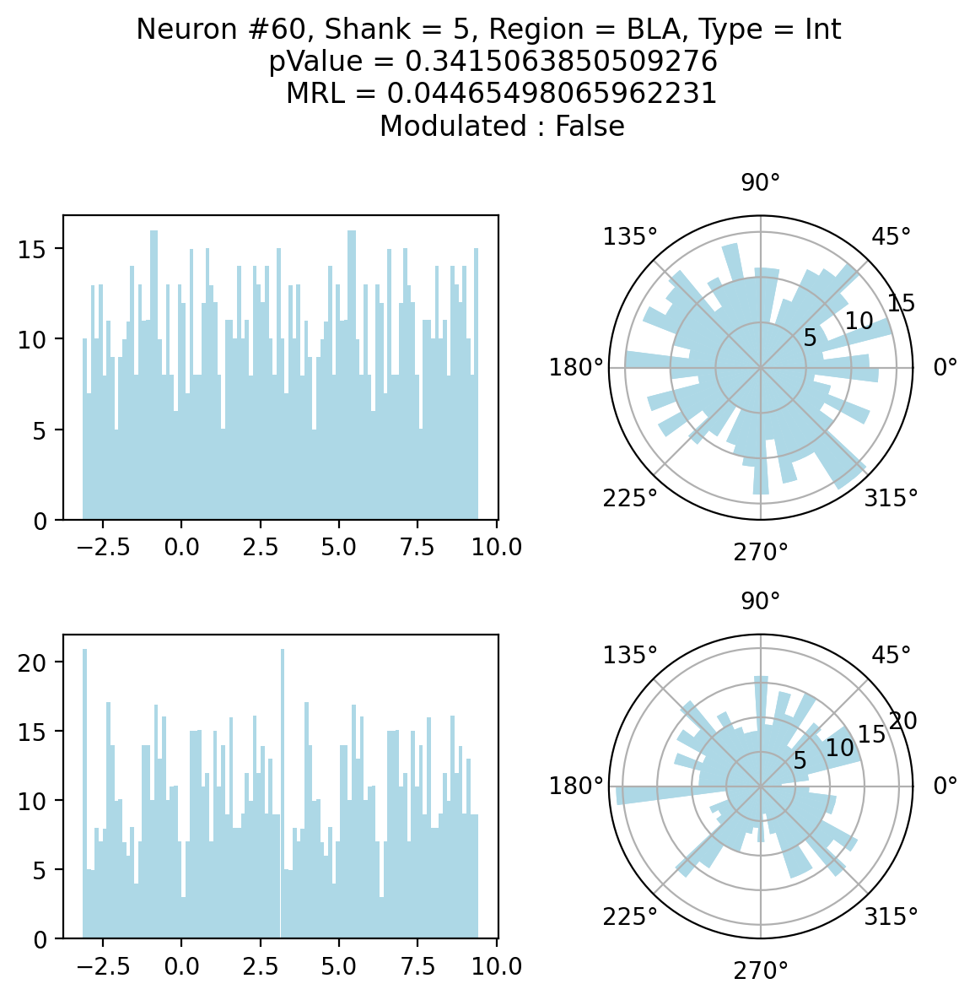

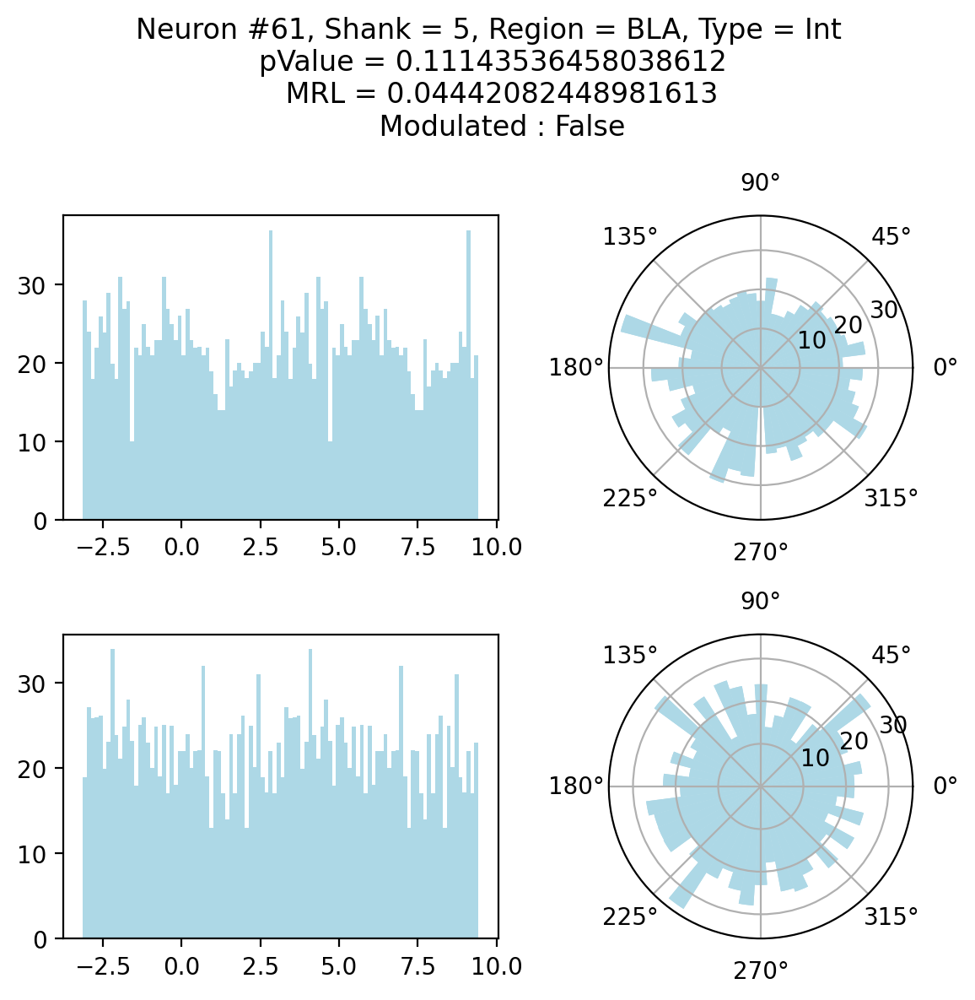

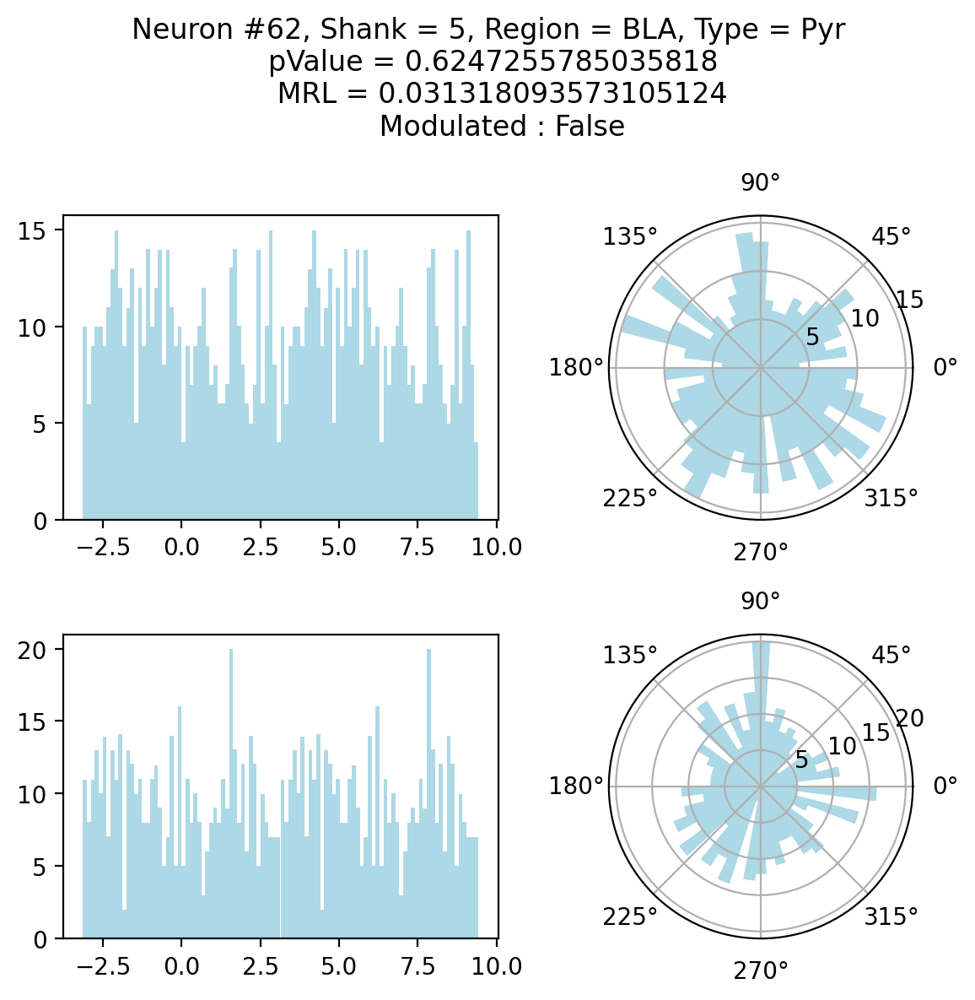

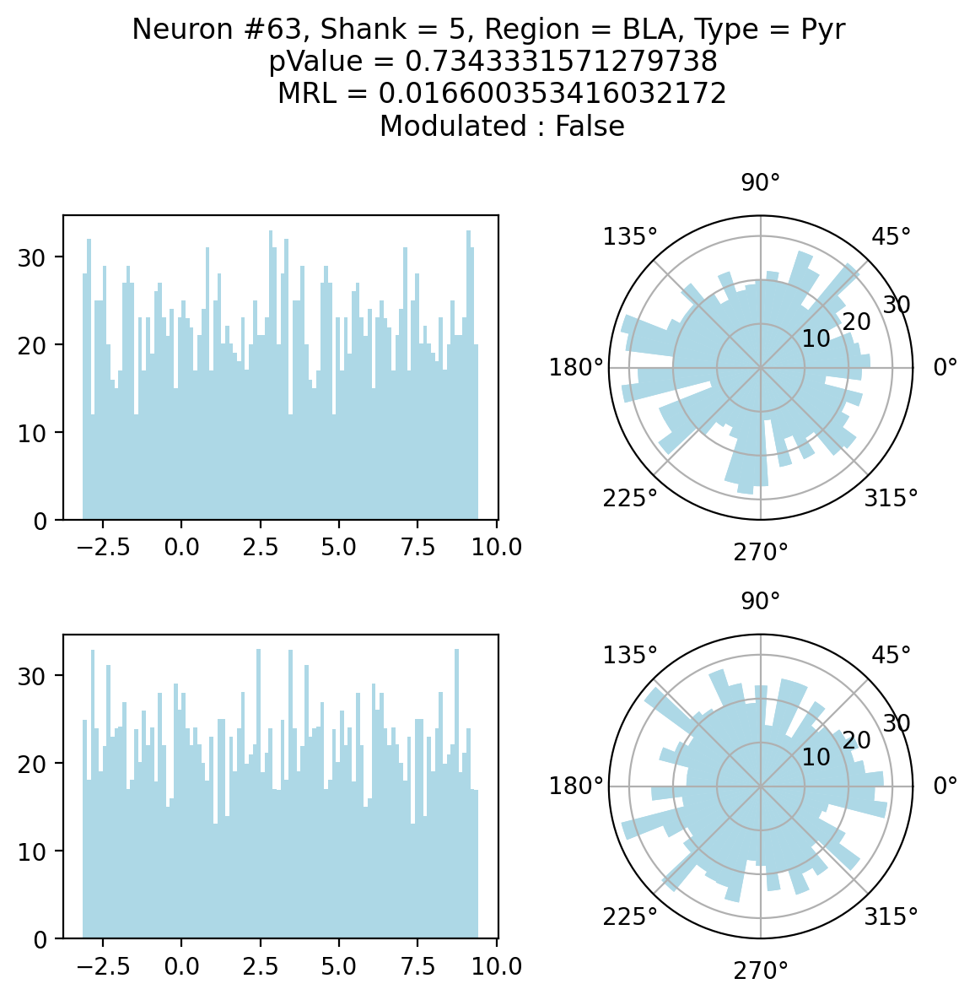

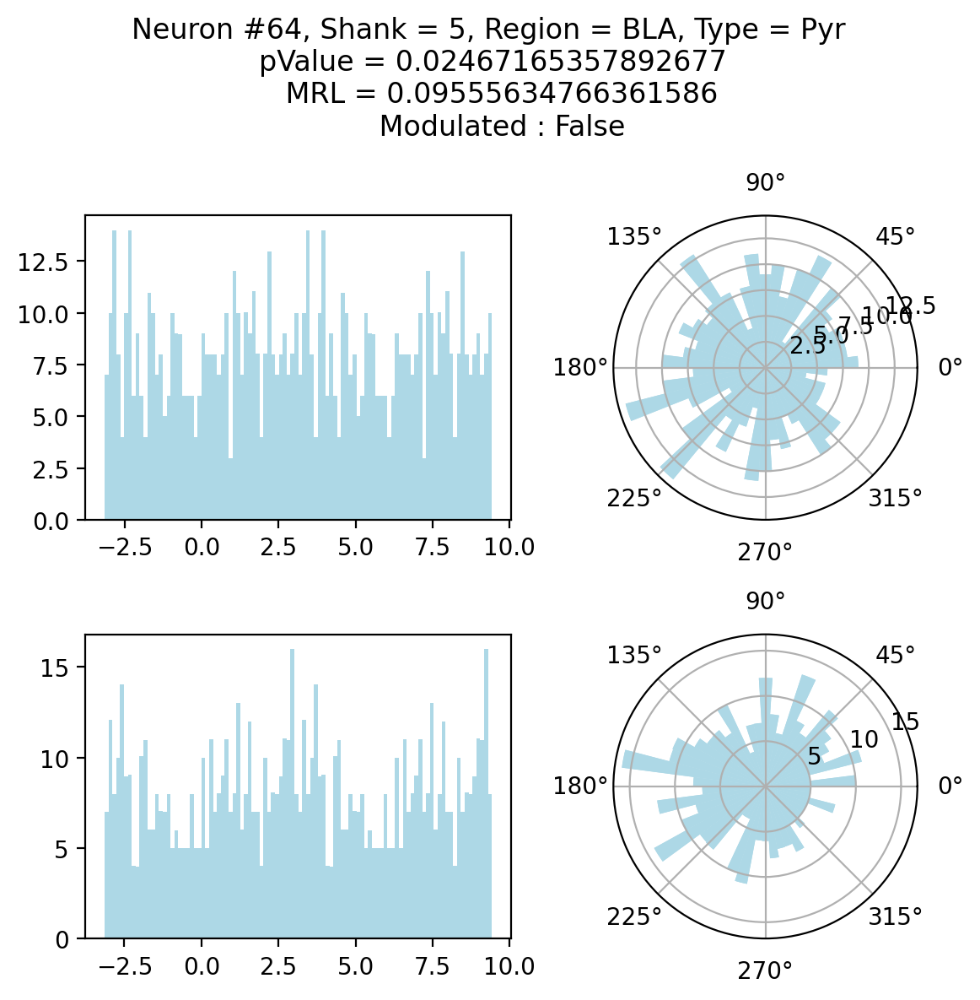

...

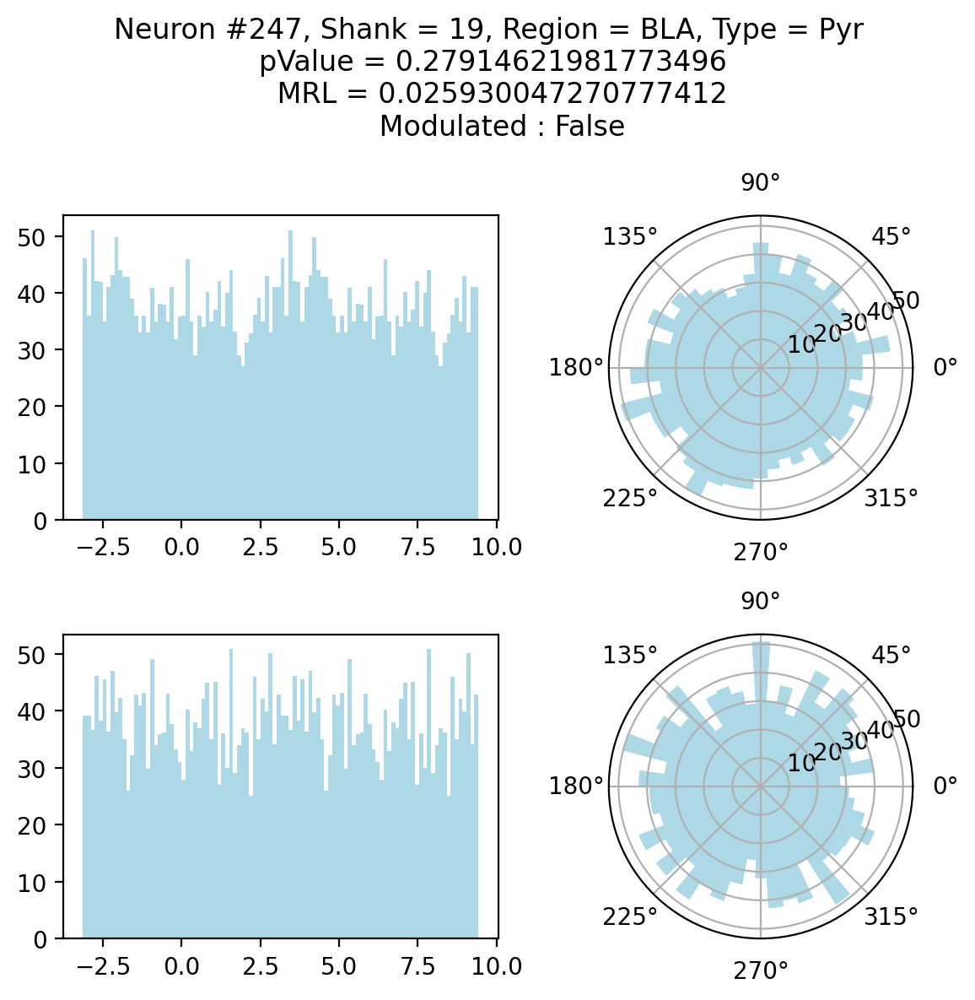

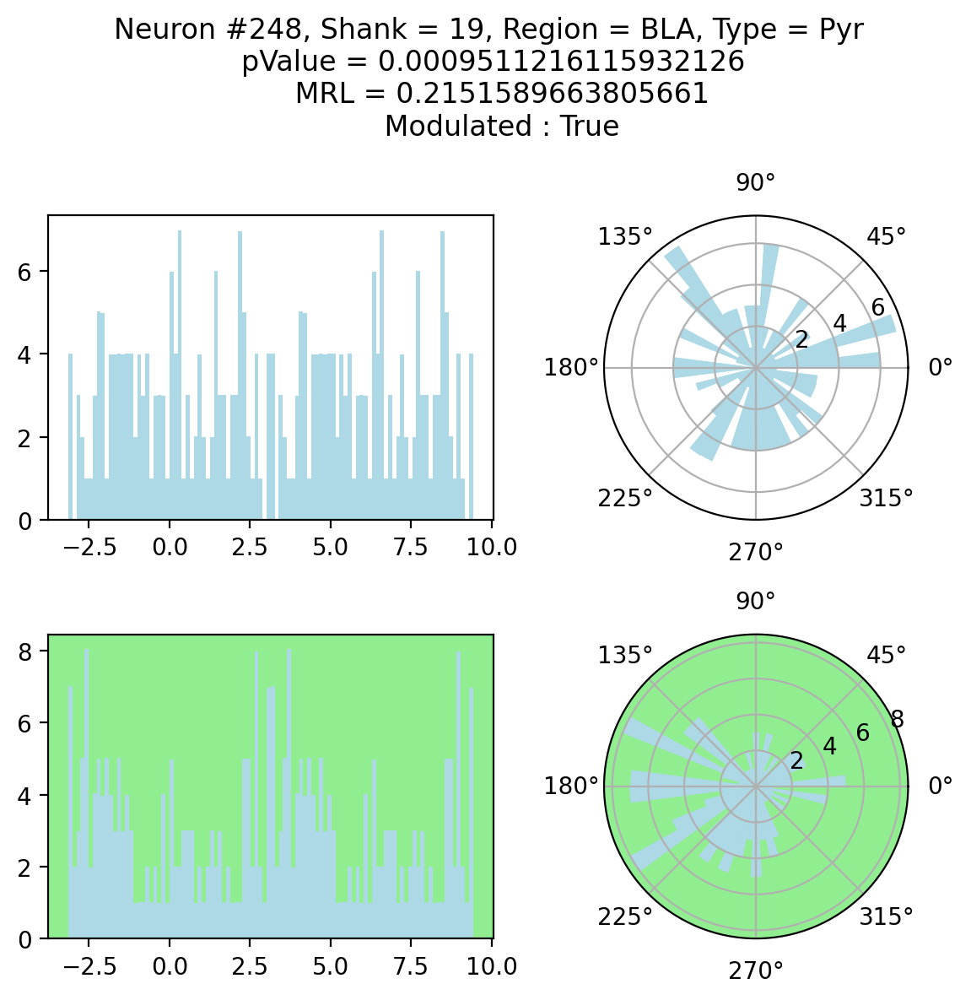

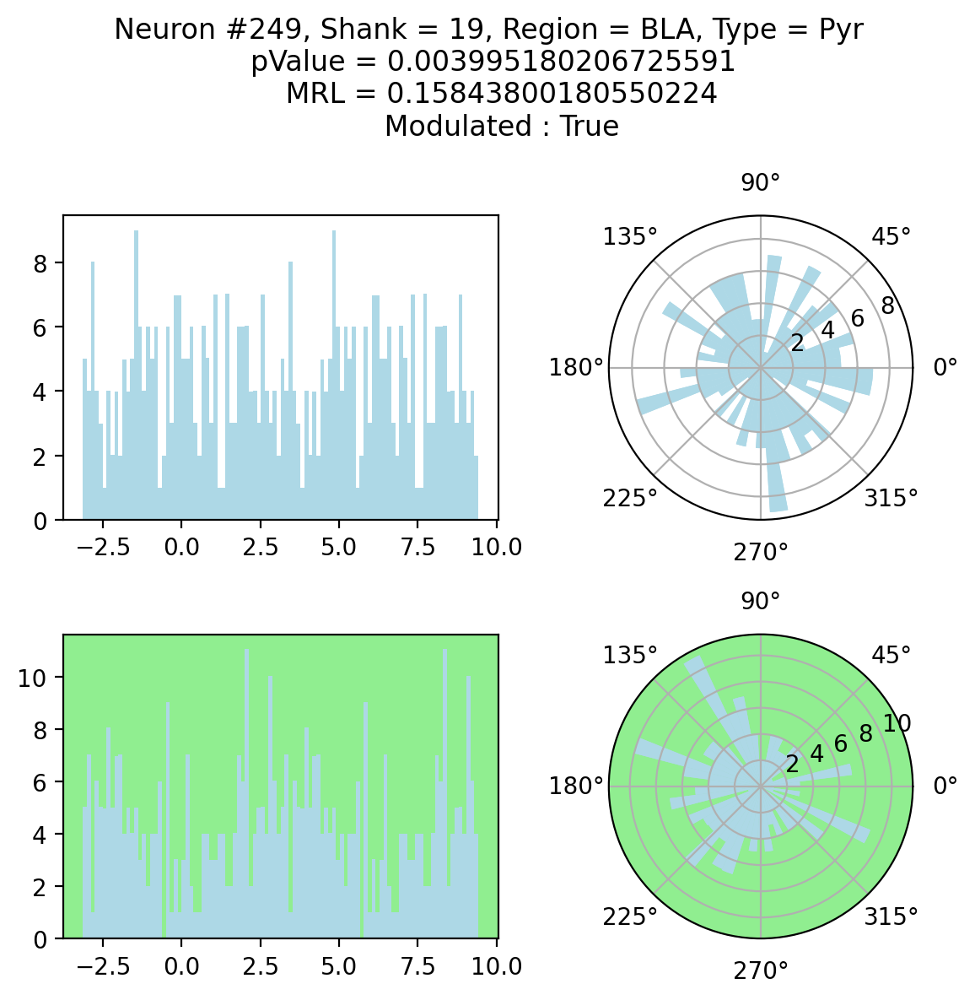

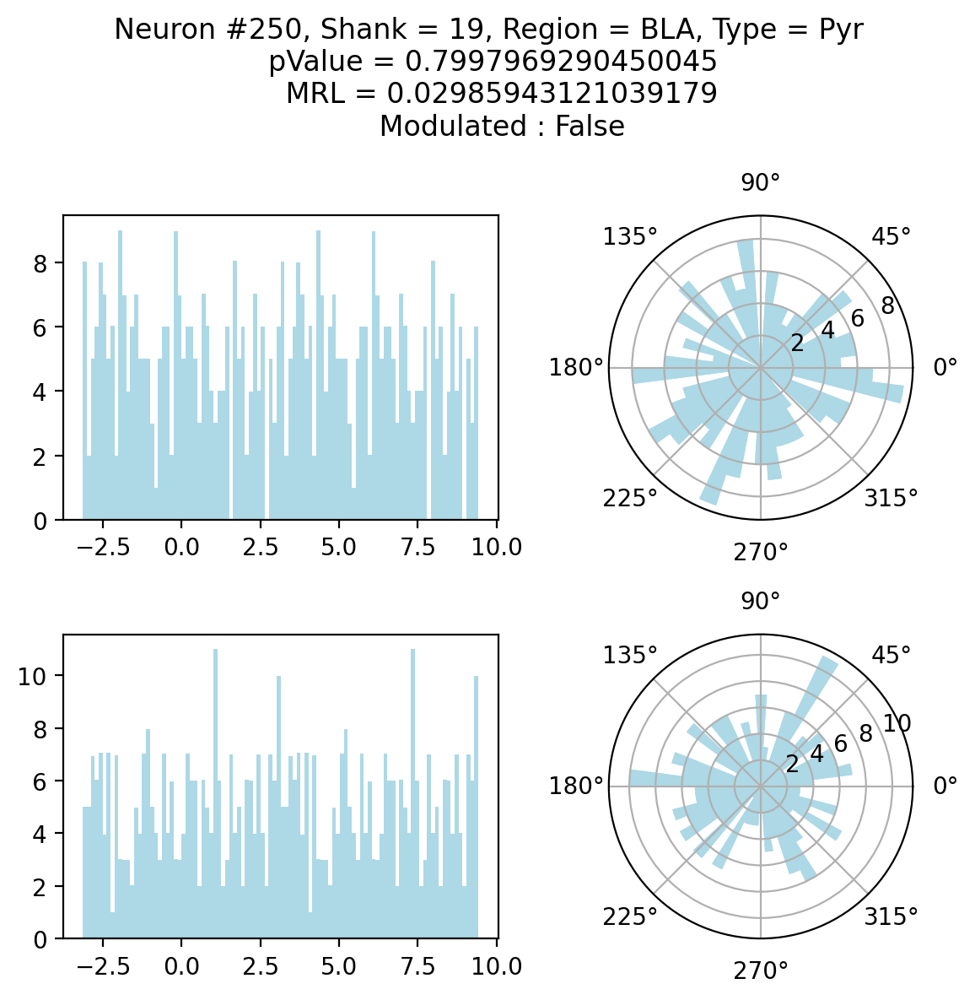

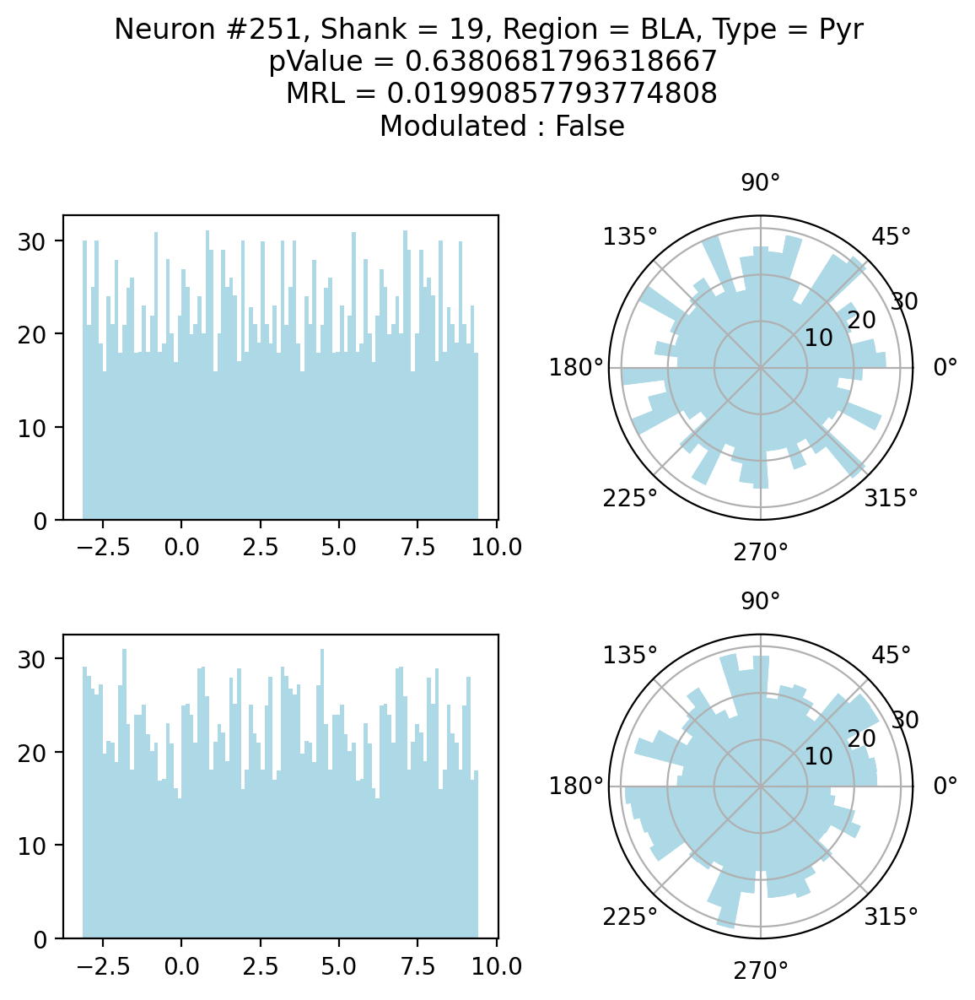

In [34]:
for i in range(252):
    if metadata_phaselock_theta.iloc[i].Region == 'BLA':
        fig,ax = plt.subplots(2,2,dpi = 200,figsize = (6,6))
        fig.delaxes(ax[0,1])
        fig.delaxes(ax[1,1])
        polar_theta = fig.add_subplot(2,2,2,polar = True)
        polar_gamma = fig.add_subplot(2,2,4,polar = True)

        plot_phase_mod(phases_theta,phases_modulations_theta[:,i],metadata_phaselock_theta.iloc[i],ax[0,0])
        plot_phase_mod(phases_theta,phases_modulations_theta[:,i],metadata_phaselock_theta.iloc[i],polar_theta)
        plot_phase_mod(phases_gamma,phases_modulations_gamma[:,i],metadata_phaselock_gamma.iloc[i],ax[1,0])
        plot_phase_mod(phases_gamma,phases_modulations_gamma[:,i],metadata_phaselock_gamma.iloc[i],polar_gamma)
        plt.tight_layout()
        

In [ ]:
fig, ax = plt.subplot_mosaic('''
                            A.
                            BC
                            ''',
                                figsize=(12, 8))
fig.set_visible = False
polar_ax = fig.add_subplot(2, 2, 2, polar=True)


ax['C'].bar(a, h, a[1]-a[0], color='lightblue')
ax['C'].bar(a+2*np.pi, h, a[1]-a[0], color='lightblue')

#     ax['C'].bar(neurons_phase[i].values+(2*np.pi),50,'blue')

ax['A'].get_shared_x_axes().join(ax['A'], ax['B'])
polar_ax.bar(a, h, a[1]-a[0])

ax['A'].set_title('LFP')
ax['A'].set_ylim([-500, 500])
ax['A'].set_xlabel('Time (s)')
ax['A'].set_ylabel('Amplitude')

ax['B'].set_title('Phase And Spikes')
ax['B'].set_xlabel('Time (s)')
ax['B'].set_ylabel('Phase (rad)')
polar_ax.set_title('PolarPlot')

ax['C'].set_title('Histogram')
ax['C'].set_xlabel('Phase (rad)')
ax['C'].set_ylabel('Spike Count')

In [15]:
# batch = bk.load.batch(main)
p,phase_mod,metadata = merge(batch)
np.sum(metadata.modulated[(metadata.Region == 'BLA') &  (metadata.Type == 'Pyr')])/np.sum((metadata.Region == 'BLA') & (metadata.Type == 'Pyr')) * 100

NameError: name 'batch' is not defined

In [23]:
states = bk.load.states()
# lfp = bk.load.lfp_in_intervals(bk.load.random_channel('BLA'),states['Rem'])
lfp_filt = bk.signal.passband(lfp,6,10,1250,2)
power, phase = bk.signal.hilbert(lfp_filt)
amp = bk.signal.enveloppe(lfp_filt)

high_theta = treshold_to_intervals(tsd_zscore(amp),1,states['Rem'])

In [26]:
states = bk.load.states()
lfp_bla = bk.load.lfp_in_intervals(bk.load.random_channel('BLA'),states['Rem'])
lfp_filt_bla = bk.signal.passband(lfp_bla,6,10,1250,2)
power, phase = bk.signal.hilbert(lfp_filt_bla)
amp_bla = bk.signal.enveloppe(lfp_filt_bla)

high_theta_bla = treshold_to_intervals(tsd_zscore(amp_bla),1,states['Rem'])


In [24]:
%matplotlib qt

In [28]:
fig,ax = plt.subplots(2,1,sharex=True)
# ax[0].plot(power)
plt.sca(ax[0])
ax[0].plot(lfp.as_units('s'),'grey',alpha = 0.7)
ax[0].plot(lfp_filt.as_units('s'),'red',alpha = 0.4)
ax[0].plot(amp.as_units('s'),'orange',alpha = 0.5)
bk.plot.intervals(high_theta)
plt.ylim(-1000,1000)
plt.title('Hpc')



plt.sca(ax[1])
ax[1].plot(lfp_bla.as_units('s'),'grey',alpha = 0.7)
ax[1].plot(lfp_filt_bla.as_units('s'),'red',alpha = 0.4)
ax[1].plot(amp_bla.as_units('s'),'orange',alpha = 0.5)
bk.plot.intervals(high_theta_bla)
plt.ylim(-1000,1000)
plt.title('BLA')

Text(0.5, 1.0, 'BLA')

In [7]:
def treshold_to_intervals(signal,treshold,intersect = None):

    interval = np.int8(signal.values.T[0] > treshold)
    interval = np.append(interval,0)
    diff_interval = np.diff(interval)
    t_start = signal.index.values[diff_interval == 1]
    t_end = signal.index.values[diff_interval == -1]
    intervals = nts.IntervalSet(t_start,t_end)
    if intersect is not None:
        intervals = intervals.intersect(intersect)
    

    return intervals

In [9]:
def tsd_zscore(tsd,axis = 0):
    from scipy.stats import zscore
    t = tsd.index.values
    q = zscore(tsd.values,axis = axis)

    return nts.TsdFrame(t,q)

In [50]:
np.sum(states['Rem'].duration(time_units = 's'))*8 /2 *1250

11855000.0

In [117]:
lfp_hpc = bk.load.lfp(bk.load.ripple_channel(),0,6000)
lfp_hpc_filt = bk.signal.passband(lfp_hpc,5,10)
amp = bk.signal.enveloppe(lfp_hpc_filt)
plt.figure()
plt.hist(amp,5000)

(array([139., 320., 462., ...,   0.,   2.,   5.]),
 array([3.49266607e-02, 2.31647299e-01, 4.28367937e-01, ...,
        9.83244677e+02, 9.83441398e+02, 9.83638119e+02]),
 <BarContainer object of 5000 artists>)

In [64]:
plt.plot(lfp_hpc.as_units('s'),'grey',alpha = 0.8)
plt.plot(lfp_hpc_filt.as_units('s'),'red',alpha = 0.6)
plt.plot(amp.as_units('s'),'orange')
bk.plot.intervals(states['Rem'])

In [66]:
fig,ax = plt.subplots(2,1,sharex=True)


plt.sca(ax[1])
ax[1].plot(lfp_bla.as_units('s'),'grey',alpha = 0.7)
ax[1].plot(lfp_filt_bla.as_units('s'),'red',alpha = 0.4)
ax[1].plot(amp_bla.as_units('s'),'orange',alpha = 0.5)
bk.plot.intervals(high_theta_bla)
plt.ylim(-1000,1000)
plt.title('BLA')

Text(0.5, 1.0, 'BLA')

In [130]:
stru = ['Hpc','BLA']
channels = [bk.load.ripple_channel(),bk.load.random_channel('BLA')]

In [131]:
lfp = {}
ratio = {}
spectrogram = {}
for s,c in zip(stru,channels):
    lfp.update({s:bk.load.lfp(c,0,6000)})
    f,t,Sxx = scipy.signal.spectrogram(lfp[s].values,1250,nperseg = 1250)

    spectrogram.update({s:Sxx})
    filt_theta = (f>5) & (f<10)
    filt_delta = (f>0.5)& (f<4)

    theta = np.mean(Sxx[filt_theta],0)
    delta = np.mean(Sxx[filt_delta],0)

    ratio.update({s:theta/delta})